# IN PROGRESS: Simple Quant Crypto (Momentum-Based) Investing Strategy

## 1. Setup

### 1.1 Load required modules

In [1]:
# Add relative path to module lookup path...
import os
import sys
sys.path.insert(0, os.path.abspath('..'))

# ... then import module
import investos as inv

# Import other required modules
import pandas as pd
pd.options.mode.chained_assignment = None  # default='warn'
pd.options.plotting.backend = "plotly"
import numpy as np

### 1.2 Load historical prices and volumes

From https://www.kaggle.com/datasets/maharshipandya/-cryptocurrency-historical-prices-dataset

In [2]:
# A. Load S&P 500 tickers, names, and industries
dir_name = './data/'

df = pd.read_csv(
    dir_name + 'crypto_dataset.csv'
).drop(columns=['Unnamed: 0'])

df['date'] = pd.to_datetime(df['date'])
df['volume'] = df['volume'] / df['close'] # Convert to volume of tokens sold, not volume in base currency

## 2. Explore dataset

### 2.1 How many distinct coins in dataset?

Notes: 
- Some days are missing data near end of period
  - Would benefit from more full dataset
- Data for less than 20 distinct tokens until ~2018 
  - Should start training model at beginning of 2018

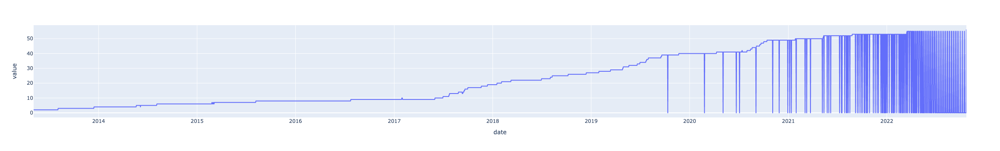

In [3]:
fig = df.resample('D', on='date')['crypto_name'].nunique().plot()
fig.layout.update(showlegend=False)
fig.show()

### 2.2 How much missing (i.e. 0 or null) data in dataset?

Notes:
- Price data looks (almost) perfect
- Market cap data looks fairly good, but will benefit from a forwardfill (vs backfill to avoid lookahead bias; 0 fill remaining nulls)
- Volume data looks almost perfect, but will benefit from a forwardfill (vs backfill to avoid lookahead bias; 0 fill remaining nulls)

In [4]:
df_missing_data = ((df == 0) | df.isnull())
df_missing_data['date'] = df['date']

df_missing_data = df_missing_data.resample('D', on='date').sum()

2.2.1 Close prices

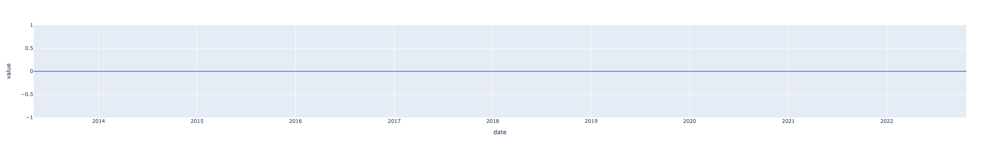

In [5]:
fig = df_missing_data['close'].plot()
fig.layout.update(showlegend=False)
fig.show()

2.2.2 High prices

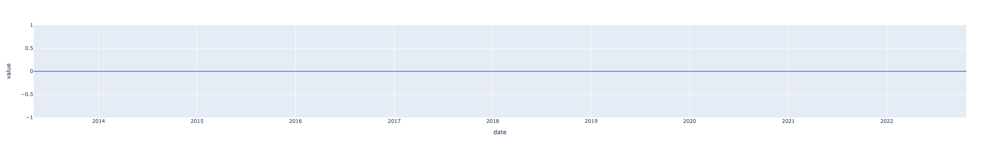

In [6]:
fig = df_missing_data['high'].plot()
fig.layout.update(showlegend=False)
fig.show()

2.2.3 Low prices

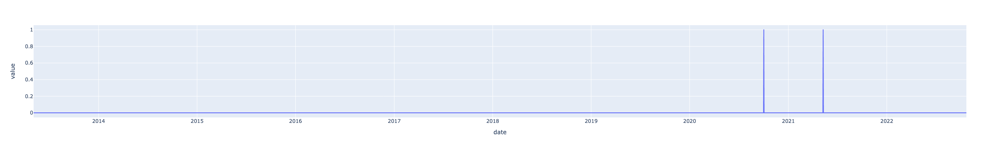

In [7]:
fig = df_missing_data['low'].plot()
fig.layout.update(showlegend=False)
fig.show()

2.2.4 Market Cap

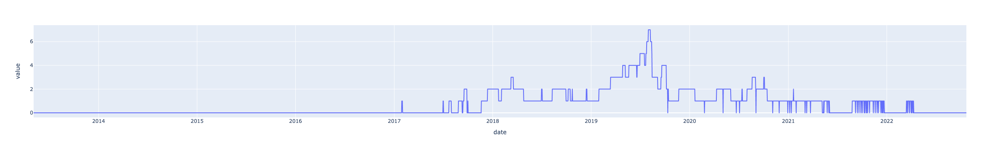

In [8]:
fig = df_missing_data['marketCap'].plot()
fig.layout.update(showlegend=False)
fig.show()

2.2.5 Volumes

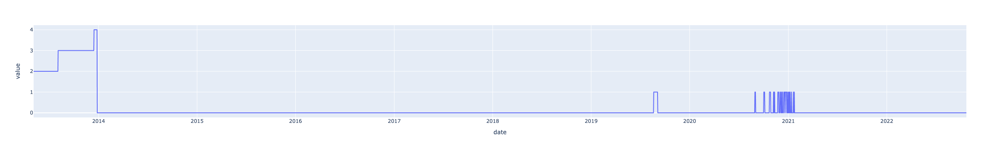

In [9]:
fig = df_missing_data['volume'].plot()
fig.layout.update(showlegend=False)
fig.show()

### 2.3 Market cap evolution by coin, stacked

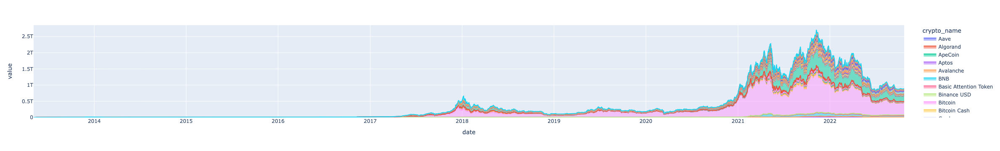

In [10]:
df_pivot = df.pivot(index='date', columns='crypto_name', values='marketCap')

fig = df_pivot.plot(kind='area')
fig.layout.update()
fig.show()

### 2.4 Gaps in time series data

Notes:
- Data gaps (from a time period perspective) get increasingly big in 2022 
  - Leave out of train/test forecasting process for now
- Should be able to use unadjusted data if train on 2018, 2019, and first half of 2020, and test on second half of 2020
  - Should redo this analysis with a less sparse dataset and test 2022 / 2023

In [11]:
df_temp = df[df.crypto_name == 'Bitcoin'].sort_values(by='date')  # Ensure the dataframe is sorted by date
df_temp['days_since_previous'] = df_temp['date'].diff().dt.days
df_temp['days_since_previous'].index = df_temp['date']

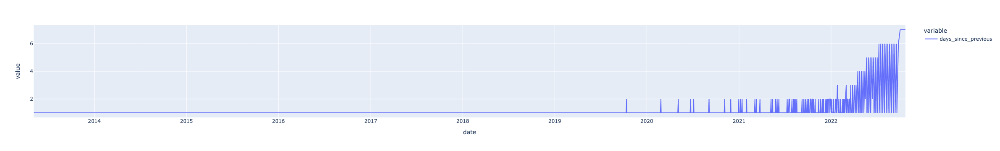

In [12]:
fig = df_temp['days_since_previous'].plot()
fig.layout.update()
fig.show()

## 3. Create features

Note: cutting dataset to Jan 1, 2018 to Dec 31, 2020

Feature format: date, id (i.e. bitcoin), feature_name, value

In [13]:
token_list = df[df['date'] == '2018-01-01']['crypto_name'].unique()

In [14]:
import datetime

date_analysis_start = datetime.datetime(2017, 9, 30)
date_analysis_end = datetime.datetime(2021, 4, 20)

df = df[
    (df['date'] >= date_analysis_start) &
    (df['date'] <= date_analysis_end) & 
    (df['crypto_name'].isin(token_list))
]

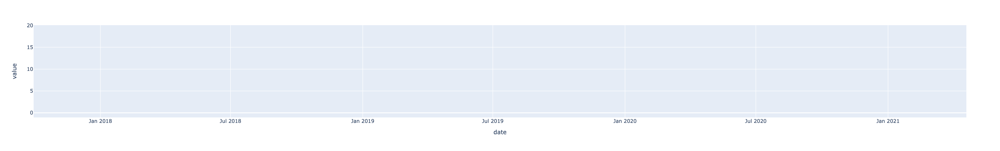

In [15]:
# Confirm data for all tickers available through entire period (other than several 2 day gaps)

fig = df.resample('D', on='date')['crypto_name'].nunique().plot()
fig.layout.update(showlegend=False)
fig.show()

### 3.1 prev_x_days_return feature

In [16]:
# Sort the DataFrame by 'ticker' and 'date'
df = df.sort_values(['crypto_name', 'date'])

# Calculate the 1-day, 7-day, and 30-day returns
for i in [1, 7, 30, 90]: 
    df[f"prev_{i}_days_return"] = df.groupby('crypto_name')['close'].pct_change(i)

### 3.2 prev_X_days_benchmark_return and pct_of_benchmark_market_cap features (i.e. market cap for entire industry)

In [17]:
df = df.merge(
    df.groupby('date', as_index=False)['marketCap'].sum().rename(
        columns={'marketCap': 'benchmark_market_cap'}
    ), 
    on='date', 
    how='left'
)

# Calculate the 1-day, 7-day, and 30-day returns
for i in [1, 7, 30, 90]: 
    df[f"prev_{i}_days_benchmark_return"] = df.groupby('crypto_name')['benchmark_market_cap'].pct_change(i)
    
df["pct_of_benchmark_market_cap"] = df['marketCap'] / df['benchmark_market_cap']

df = df.drop(columns=['benchmark_market_cap'])

### 3.3 prev_X_days_return_less_benchmark feature

In [18]:
for i in [1, 7, 30, 90]: 
    df[f"prev_{i}_days_return_less_benchmark"] = df[f"prev_{i}_days_return"] - df[f"prev_{i}_days_benchmark_return"]

### 3.4 premium_to_prev_X_days_vwap feature

In [19]:
df['price_vol'] = df['close'] * df['volume']

for i in [7, 30, 90]:
    # Calculate the rolling sum of 'price_vol' and 'volume' over 7 days for each ticker
    df['price_vol_sum'] = df.groupby('crypto_name').rolling(f"{i}D", on='date')['price_vol'].sum().reset_index()['price_vol']
    df['volume_sum'] = df.groupby('crypto_name').rolling(f"{i}D", on='date')['volume'].sum().reset_index()['volume']

    # Calculate VWAP
    df[f"vwap_prev_{i}_days"] = df['price_vol_sum'] / df['volume_sum']

    # Remove the intermediate columns
    df = df.drop(columns=['price_vol_sum', 'volume_sum'])
    
df = df.drop(columns=['price_vol'])

In [20]:
for i in [7, 30, 90]:
    df[f"premium_to_prev_{i}_days_vwap"] = df['close'] / df[f"vwap_prev_{i}_days"] - 1
    df = df.drop(columns=[f"vwap_prev_{i}_days"])

### 3.5 prev_x_days_spread_pct_of_price AND discount_to_prev_x_days_max_price features

In [21]:
for i in [1, 7, 30, 90]:
    df['high_max'] = df.groupby('crypto_name').rolling(f"{i}D", on='date')["high"].max().reset_index()['high']
    df['low_min'] = df.groupby('crypto_name').rolling(f"{i}D", on='date')["low"].min().reset_index()['low']

    df[f"prev_{i}_days_spread_pct_of_price"] = (df['high_max'] - df['low_min']) / df["close"]
    df[f"discount_to_prev_{i}_days_max_price"] = df["close"] / df['high_max'] - 1

    df = df.drop(columns=['high_max', 'low_min'])

### 3.6 Create fwd_x_days_return targets

In [22]:
for i in [1, 7, 30, 90]:
    df[f"fwd_{i}_days_return"] = df.groupby(['crypto_name'])['close'].shift(-i) / df['close'] - 1

### 3.7 Keep only 2018 through 2020 for ML training and testing

In [23]:
date_analysis_start = datetime.datetime(2018, 1, 1)
date_analysis_end = datetime.datetime(2020, 12, 31)

df = df[
    (df['date'] >= date_analysis_start) &
    (df['date'] <= date_analysis_end) & 
    (df['crypto_name'].isin(token_list))
]

### 3.8 Clean then convert features to standard feature format

date, id (i.e. bitcoin), feature_name, value

In [24]:
# Rename columns
df = df.rename(columns={
    'close': 'price',
    'crypto_name': 'asset',
})

# Save actuals
df_actual = df[["price", "date", "volume", "asset", "fwd_1_days_return"]].rename(columns={
    'fwd_1_days_return': 'return',
})

# Note: real data should be used for this, wherever possible
# For now, assume 0.01% (i.e. 1 cent on $100.00 token)
df_actual['spread'] = 1/10_000 # EXPECTED AS A PERCENT

In [25]:
df = df.drop(columns=["open", "high", "low", "price", "volume", "marketCap", "timestamp"])

In [26]:
# Convert features to standard format
df_features = df.melt(id_vars=['date', 'asset'], var_name='feature_name', value_name='value')
df_features['target'] = df_features['feature_name'].str.contains('fwd')

Other notes / todos:
- What features are most predictive? Look at shap values
- What other datasets might be interesting to look at?
  - Sentiment:
    - Clickstream data / search volume:
      - https://trends.google.com/trends/explore?date=today%205-y&geo=CA&q=%2Fm%2F05p0rrx&hl=en 
    - BTC sentiment: 
      - https://www.kaggle.com/datasets/gauravduttakiit/bitcoin-tweets-16m-tweets-with-sentiment-tagged
    - Consumer sentiment data: 
      - https://ycharts.com/indicators/us_consumer_sentiment_index#:~:text=Basic%20Info,27.80%25%20from%20one%20year%20ago. 
    - Other ideas:
      - Stock market indices
      - Oil prices
      - News / twitter mentions and sentiment

## 4. Forecasting fwd returns

In [27]:
import xgboost as xgb

df_features = df_features.sort_values(['date', 'asset'])

# Define the features and target
X = df_features[df_features['target'] == False].pivot(
    index=['date', 'asset'], 
    columns='feature_name', 
    values='value'
).reset_index()

y = df_features[df_features['target'] == True].pivot(
    index=['date', 'asset'], 
    columns='feature_name', 
    values='value'
).reset_index()["fwd_1_days_return"]

# # Let's say we want to use 80% of the data for training and 20% for testing
train_size = int(
    len(
        X[X['date'] < '2020-07-01']
    )
)

# Split the data
X_train, X_test = X[:train_size].drop(columns=["date", "asset"]), X[train_size:].drop(columns=["date", "asset"])
y_train, y_test = y[:train_size].drop(columns=["date", "asset"]), y[train_size:].drop(columns=["date", "asset"])

In [28]:
# Initialize and train the XGBoost regressor
model = xgb.XGBRegressor(
    n_estimators=100, 
    random_state=42,
)

# Fit model
model.fit(X_train, y_train)

# Make predictions on the test set
predictions = model.predict(X_test)

In [29]:
# Predictions right sign X% of the time?
agree_on_sign = np.sign(predictions) == np.sign(y_test)

print(
    "Return predictions have the right sign %.1f%% of the time" %
    ((agree_on_sign.sum() / agree_on_sign.shape[0]) * 100)
)

Return predictions have the right sign 51.4% of the time


In [30]:
print("Predict neg: ", len(predictions[predictions < 0]), "Predict pos:", len(predictions[predictions >= 0]))
print("Actual neg: ", len(y_test[y_test < 0]), "Actual pos:", len(y_test[y_test >= 0]))

Predict neg:  1880 Predict pos: 1521
Actual neg:  1596 Actual pos: 1805


## 5. Backtesting trading performance of forecasts

Notes:
- Assumes spreads are 0.01% (i.e. 1 cent on $100.00 stock)
- Assumes no trading costs beyond spreads and price movement caused by trading volume

### 5.1 Transform data

In [34]:
df_forecast = X[["date", "asset"]][train_size:]
df_forecast['return'] = predictions
# Note: real data should be used for this, wherever possible
# For now, assume 0.01% (i.e. 1 cent on $100.00 token)
df_forecast['spread'] = 1/10_000 # EXPECTED AS A PERCENT

In [35]:
from investos.portfolio.cost_model import *
from investos.portfolio.constraint_model import *
from investos.portfolio.risk_model import *

In [36]:
strategy = inv.portfolio.strategy.SPO(
    constraints = [
        MaxLeverageConstraint(limit=1.0),
        MinWeightConstraint(limit=-0.2), 
        MaxWeightConstraint(limit=0.2), 
        EqualLongShortConstraint() 
    ],
    costs = [
        TradingCost() * 10, 
        HoldingCost(),
    ],
)

portfolio = inv.portfolio.Controller(
    df_forecast,
    df_actual,
    strategy=strategy,
    aum=10_000_000
)

In [37]:
backtest_result = portfolio.generate_positions()

Optimizing...
Done simulating.


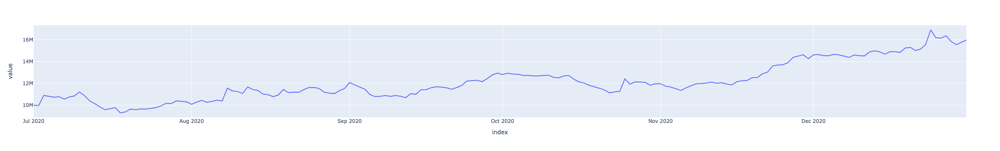

In [38]:
fig = backtest_result.v.plot()
fig.layout.update(showlegend=False)
fig.show()

In [39]:
backtest_result.summary

Number of periods                                  179
Initial timestamp                  2020-07-01 00:00:00
Final timestamp                    2020-12-31 00:00:00
Annualized portfolio return (%)                154.65%
Total portfolio return (%)                      59.78%
Sharpe ratio                                     2.329
Max drawdown                                    17.05%
Annual turnover (x)                            378.97x
